# Train different Diffusion Model (DM) variants with different neural network backbones on a simple vector-target task

In [1]:
%load_ext autoreload
%autoreload 2

## Define Targets

In [2]:
import numpy as np

targets = [[0.1, -3.0, 4.0],
           [-2., 1.0, 2.5],
           [1.0, 1.4, -1.],
           [6.0, -2.0, 0.0]
           ]

targets = np.array(targets)

fitness = [10.0, 5.0, 5.0, 20.]
fitness = np.array(fitness)

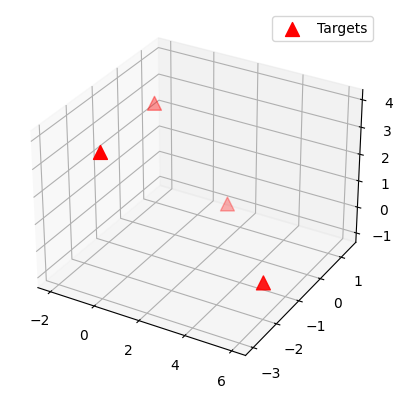

In [3]:
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(targets[:, 0], targets[:, 1], targets[:, 2], c='r', marker='^', s=100, label='Targets')
ax.legend()
plt.show()

## Imports & Helpers

In [4]:
from condevo.diffusion import RectFlow, DDIM, VPred
from condevo.nn import MLP, UNet, SelfAttentionMLP
from condevo.es.utils import roulette_wheel

In [8]:
def get_ddim(model, backbone,
             skip_connection=False,
             num_steps=300,
             alpha_schedule="cosine_nichol",
             noise_level=1.0,
             diff_range=10,
             diff_range_filter=True,
             clip_gradients=1.,
             ):
    log_dir = f"data/ddim_{backbone}"
    return DDIM(nn=model, skip_connection=skip_connection, num_steps=num_steps, alpha_schedule=alpha_schedule, noise_level=noise_level, diff_range=diff_range, diff_range_filter=diff_range_filter, clip_gradients=clip_gradients, log_dir=log_dir)


def get_vpred(model, backbone,
              skip_connection=False,
              num_steps=300,
              alpha_schedule="cosine_nichol",
              noise_level=1.0,
              diff_range=10,
              diff_range_filter=True,
              clip_gradients=1.,
              ):
    log_dir = f"data/vpred_{backbone}"
    return VPred(nn=model, skip_connection=skip_connection, num_steps=num_steps, alpha_schedule=alpha_schedule, noise_level=noise_level, diff_range=diff_range, diff_range_filter=diff_range_filter, clip_gradients=clip_gradients, log_dir=log_dir)


def get_xpred(model, backbone,
              num_steps=300,
              alpha_schedule="cosine_nichol",
              noise_level=1.0,
              diff_range=10,
              diff_range_filter=True,
              clip_gradients=1.,
              ):
    log_dir = f"data/xpred_{backbone}"
    from condevo.diffusion.x_prediction import XPred
    return XPred(nn=model, num_steps=num_steps, alpha_schedule=alpha_schedule, noise_level=noise_level, diff_range=diff_range, diff_range_filter=diff_range_filter, clip_gradients=clip_gradients, log_dir=log_dir)


def get_rflow(model, backbone,
              num_steps=50,
              noise_level=1.0,
              diff_range=10,
              diff_range_filter=True,
              clip_gradients=1.,
              ):
    log_dir = f"data/RFlow_{backbone}"

    return RectFlow(nn=model, num_steps=num_steps, noise_level=noise_level, diff_range=diff_range, diff_range_filter=diff_range_filter, clip_gradients=clip_gradients, log_dir=log_dir)


In [9]:
num_params = targets.shape[-1]


def get_mlp(num_hidden=64,
            num_layers=6,
            activation="GELU",
            dropout=0.0,
            layer_norm=False,
            batch_norm=False,
            time_embedding=0,  # 0: disable, >1: train linear projection layer for time embedding
            ):
    return MLP(num_params=num_params, num_hidden=num_hidden, num_layers=num_layers, activation=activation, dropout=dropout, layer_norm=layer_norm, batch_norm=batch_norm, time_embedding=time_embedding)

def get_unet(num_hidden=[16, 32, 64, 96],  # encoding side of the "U"
             activation="GELU",
             dropout=0.0,
             layer_norm=True,
             batch_norm=False,
             time_embedding=0,
             ):
    return UNet(num_params=num_params, num_hidden=num_hidden, activation=activation, dropout=dropout, layer_norm=layer_norm, batch_norm=batch_norm, time_embedding=time_embedding)

def get_attn(num_hidden=32,
             num_heads=4,
             num_layers=4,
             activation="GELU",
             dropout=0.0,
             batch_norm=False,
             time_embedding=0,
             ):
    return SelfAttentionMLP(num_params=num_params, num_hidden=num_hidden, num_heads=num_heads, num_layers=num_layers, activation=activation, dropout=dropout, batch_norm=batch_norm, time_embedding=time_embedding,
        )

## Train DDIM model with MLP backbone

In [7]:
import torch

dataset_size = 1000
max_epochs   =  100
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
for t, f, w in zip(targets, fitness, weights):
    print(f"target {t} with fitness {f} is weighted as {w}")

target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=None, replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

# initialize model
backbone = get_mlp()
# backbone = get_unet()
ddim = get_ddim(model=backbone, backbone="mlp_test")
ddim = ddim.to(device)

# train
history = ddim.fit(
    x,
    weights=f,
    max_epoch=max_epochs,
    lr=3e-3,
    optimizer="Adam",
    weight_decay=1e-5,
)

target [ 0.1 -3.   4. ] with fitness 10.0 is weighted as 0.25191763043403625
target [-2.   1.   2.5] with fitness 5.0 is weighted as 0.10515791922807693
target [ 1.   1.4 -1. ] with fitness 5.0 is weighted as 0.10515791922807693
target [ 6. -2.  0.] with fitness 20.0 is weighted as 0.5377665162086487


Training Diffusion Model: 100%|██████████| 100/100 [00:20<00:00,  4.98epoch/s, loss=0.0253]


In [8]:
samples = ddim.sample(shape=(num_params,), num=1000)

count = []
for t in targets:
    dt = torch.linalg.norm(samples - t, dim=-1)
    count.append((dt < 0.5).sum().item() / len(samples))

for t, f, w, c in zip(targets, fitness, weights, count):
    print(f"target {t} weighted by {w:.3f}: sampling rate {c}")


target [ 0.1 -3.   4. ] weighted by 0.252: sampling rate 0.27
target [-2.   1.   2.5] weighted by 0.105: sampling rate 0.082
target [ 1.   1.4 -1. ] weighted by 0.105: sampling rate 0.1
target [ 6. -2.  0.] weighted by 0.538: sampling rate 0.547


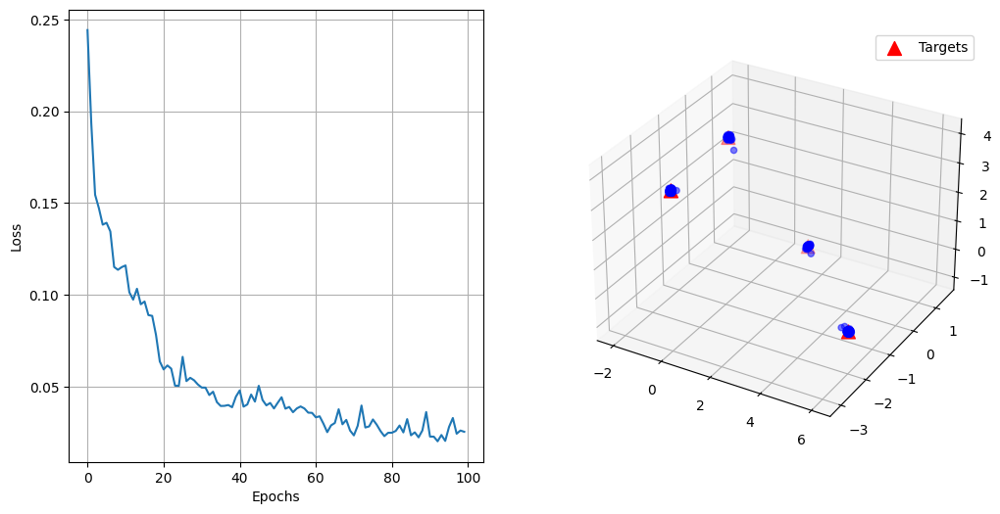

In [9]:
fig = plt.figure(figsize=(12, 6))
ax_hist = fig.add_subplot(121)
ax_hist.plot(history)
ax_hist.set_xlabel("Epochs")
ax_hist.set_ylabel("Loss")
ax_hist.grid()

ax = fig.add_subplot(122, projection='3d')

ax.scatter(samples[:, 0], samples[:, 1], samples[:, 2], c='b', marker='o', alpha=0.5)
ax.scatter(targets[:, 0], targets[:, 1], targets[:, 2], c='r', marker='^', s=100, label='Targets')
ax.legend()
plt.show()

### Analyze the denoising stack of DDIM models

In [10]:
@torch.no_grad()
def sample(model, num_samples, num_params, t_start=None):
    # sample entire denoising stack (num_(t_)steps, num_samples, num_params) for t in [T, 0]
    if t_start is None:
        t_start = model.num_steps - 1

    xt = torch.randn(t_start + 1, num_samples, num_params)  # RETURN entire denoising stack
    one = torch.ones(num_samples, 1, device=xt.device, dtype=xt.dtype)

    for T in range(t_start, 0, -1):
        t = one * model._step_discrete_to_continuous(T)
        a = model.alpha[T-1]
        s = model.sigma[T] * model.noise_level
        z = torch.randn_like(xt[T])

        eps = model.predict_eps(xt[T], t)
        eps, x0_pred = model.get_clamped_eps_x0(xt[T], eps, T)

        eps_sqrt_term = (1 - a - s ** 2).clamp_min(0).sqrt()
        xt[T-1] = a.sqrt() * x0_pred + eps_sqrt_term * eps + s * z

    return xt

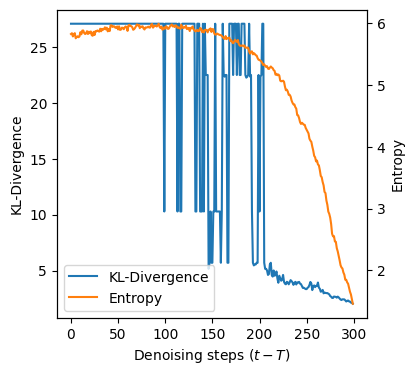

In [11]:
from condevo.stats import kl_divergence_sampled
from condevo.stats import grid_entropy_2d

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

# sample data
samples = sample(ddim,500, 3)

# eval statistics
entropy = [grid_entropy_2d(xt, grid_size=51, range_min=-ddim.diff_range, range_max=ddim.diff_range) for xt in reversed(samples)]
KL_divergence = [kl_divergence_sampled(px, px_hat, grid_size=51, range_min=-ddim.diff_range, range_max=ddim.diff_range) for px_hat in reversed(samples)]

# plot statistics
fig = plt.figure(figsize=(4, 4))
ax = plt.gca()
ax.plot(np.arange(ddim.num_steps), KL_divergence)
ax.set_ylabel("KL-Divergence")
ax.set_xlabel("Denoising steps $(t-T)$")

t_ax = plt.twinx()
t_ax.plot([], label="KL-Divergence")
t_ax.plot(np.arange(ddim.num_steps), entropy, color="tab:orange", label="Entropy")
plt.ylabel("Entropy")
plt.legend()
plt.show()

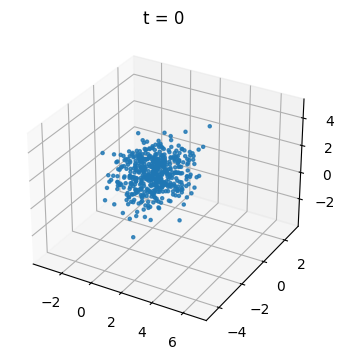

In [12]:
##### plot denoising over time
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

T, N, _ = samples.shape
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111, projection="3d")

# Ensure numpy float array (handles torch tensors too)
samples_np = np.asarray(samples, dtype=float)[::-1]

# Fixed limits
lims = [(samples_np[..., i].min(), samples_np[..., i].max()) for i in range(3)]
ax.set_xlim(lims[0]); ax.set_ylim(lims[1]); ax.set_zlim(lims[2])

# Init
xyz0 = samples_np[0]
scat = ax.scatter(xyz0[:, 0], xyz0[:, 1], xyz0[:, 2], s=5, alpha=0.8)
title = ax.set_title("t = 0")

def update(frame):
    xyz = samples_np[frame]              # (N, 3)
    x = np.asarray(xyz[:, 0]).reshape(-1)
    y = np.asarray(xyz[:, 1]).reshape(-1)
    z = np.asarray(xyz[:, 2]).reshape(-1)
    scat._offsets3d = (x, y, z)
    title.set_text(f"t = {frame}")
    return scat, title

anim = FuncAnimation(fig, update, frames=T, interval=50, blit=False)

display(HTML(anim.to_jshtml()))

## Train RectFlow model with MLP backbone

In [13]:
dataset_size = 1000
max_epochs   =  200
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
for t, f, w in zip(targets, fitness, weights):
    print(f"target {t} with fitness {f} is weighted as {w}")

target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=weights.numpy(), replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

# initialize model
backbone = get_mlp()
# backbone = get_unet()
rflow = get_rflow(backbone, "mlp_test").to(device)

# train
history = rflow.fit(
    x,
    weights=f,
    max_epoch=max_epochs,
    lr=3e-3,
    optimizer="Adam",
    weight_decay=1e-5,
)

target [ 0.1 -3.   4. ] with fitness 10.0 is weighted as 0.25191763043403625
target [-2.   1.   2.5] with fitness 5.0 is weighted as 0.10515791922807693
target [ 1.   1.4 -1. ] with fitness 5.0 is weighted as 0.10515791922807693
target [ 6. -2.  0.] with fitness 20.0 is weighted as 0.5377665162086487


Training Diffusion Model: 100%|██████████| 200/200 [00:43<00:00,  4.58epoch/s, loss=0.432]


In [14]:
samples = rflow.sample(shape=(num_params,), num=1000)

count = []
for t in targets:
    dt = torch.linalg.norm(samples - t, dim=-1)
    count.append((dt < 0.5).sum().item() / len(samples))

for t, f, w, c in zip(targets, fitness, weights, count):
    print(f"target {t} weighted by {w:.3f}: sampling rate {c}")


target [ 0.1 -3.   4. ] weighted by 0.252: sampling rate 0.184
target [-2.   1.   2.5] weighted by 0.105: sampling rate 0.03
target [ 1.   1.4 -1. ] weighted by 0.105: sampling rate 0.037
target [ 6. -2.  0.] weighted by 0.538: sampling rate 0.733


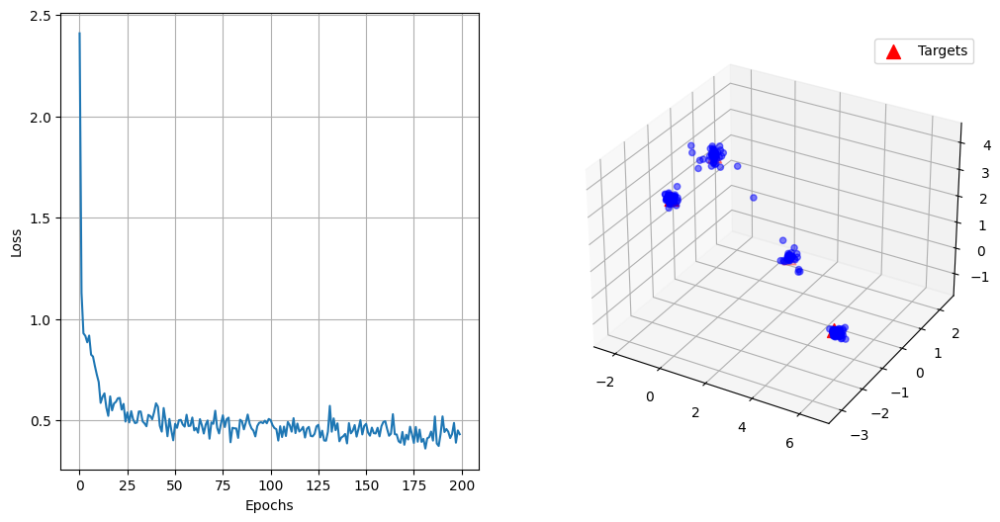

In [15]:
fig = plt.figure(figsize=(12, 6))
ax_hist = fig.add_subplot(121)
ax_hist.plot(history)
ax_hist.set_xlabel("Epochs")
ax_hist.set_ylabel("Loss")
ax_hist.grid()

ax = fig.add_subplot(122, projection='3d')
samples = rflow.sample(shape=(num_params,), num=1000)
ax.scatter(samples[:, 0], samples[:, 1], samples[:, 2], c='b', marker='o', alpha=0.5)
ax.scatter(targets[:, 0], targets[:, 1], targets[:, 2], c='r', marker='^', s=100, label='Targets')
ax.legend()
plt.show()

In [16]:
@torch.no_grad()
def rflow_sample(model, num_samples, num_params, t_start=None):
    # sample entire denoising stack (num_(t_)steps, num_samples, num_params) for t in [T, 0]
    if t_start is None:
        t_start = 0

    xtt = torch.randn(model.num_steps, num_samples, num_params)  # RETURN entire denoising stack
    tt = torch.linspace(0, 1, model.num_steps, device=model.device).view(-1, 1)  # (T,1)
    dt = 1. / model.num_steps * model.matthew_factor

    xt = xtt[0]
    for T in range(t_start, model.num_steps):
        t = tt[T].expand(xt.size(0), 1)  # (B,1)
        v = model(xt, t)
        xt = xt + v * dt

        if model.noise_level:
            xt += (dt ** 0.5) * torch.randn_like(xt) * model.noise_level * (1 - t)

        if model.diff_range_filter:
            xt = model.diff_clamp(xt)

        xtt[T, ...] = xt.clone()

    return xtt

Text(0, 0.5, 'Entropy')

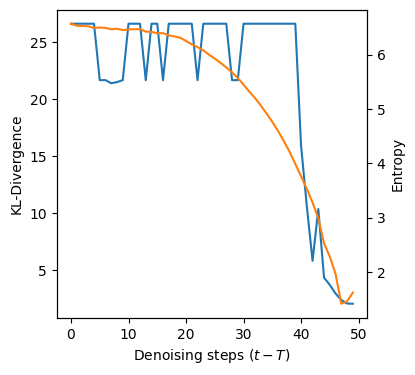

In [17]:
from condevo.stats import kl_divergence_sampled
from condevo.stats import grid_entropy_2d

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

# sample data
samples = rflow_sample(rflow, 2000, 3)

# eval statistics
entropy = [grid_entropy_2d(xt, grid_size=51, range_min=-rflow.diff_range, range_max=rflow.diff_range) for xt in samples]
KL_divergence = [kl_divergence_sampled(px, px_hat, grid_size=51, range_min=-rflow.diff_range, range_max=rflow.diff_range) for px_hat in samples]

# plot statistics
fig = plt.figure(figsize=(4, 4))
ax = plt.gca()
ax.plot(np.arange(rflow.num_steps), KL_divergence)
ax.set_ylabel("KL-Divergence")
ax.set_xlabel("Denoising steps $(t-T)$")

t_ax = plt.twinx()
t_ax.plot(np.arange(rflow.num_steps), entropy, color="tab:orange")
plt.ylabel("Entropy")

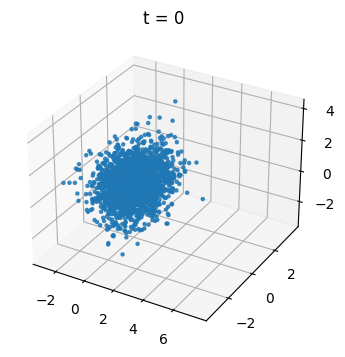

In [18]:
##### plot denoising over time
T, N, _ = samples.shape
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111, projection="3d")

# Ensure numpy float array (handles torch tensors too)
samples_np = np.asarray(samples, dtype=float)

# Fixed limits
lims = [(samples_np[..., i].min(), samples_np[..., i].max()) for i in range(3)]
ax.set_xlim(lims[0]); ax.set_ylim(lims[1]); ax.set_zlim(lims[2])

# Init
xyz0 = samples_np[0]
scat = ax.scatter(xyz0[:, 0], xyz0[:, 1], xyz0[:, 2], s=5, alpha=0.8)
title = ax.set_title("t = 0")

def update(frame):
    xyz = samples_np[frame]              # (N, 3)
    x = np.asarray(xyz[:, 0]).reshape(-1)
    y = np.asarray(xyz[:, 1]).reshape(-1)
    z = np.asarray(xyz[:, 2]).reshape(-1)
    scat._offsets3d = (x, y, z)
    title.set_text(f"t = {frame}")
    return scat, title

anim = FuncAnimation(fig, update, frames=T, interval=50, blit=False)

display(HTML(anim.to_jshtml()))

## Train V-Prediction Model (less steps like RFlow, but better performance)

In [19]:
import torch

dataset_size = 1000
max_epochs   =  100
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
for t, f, w in zip(targets, fitness, weights):
    print(f"target {t} with fitness {f} is weighted as {w}")

target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=None, replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

# initialize model
backbone = get_mlp()
# backbone = get_unet()
vpred = get_vpred(backbone, "mlp_test")
vpred = vpred.to(device)

# train
history = vpred.fit(
    x,
    weights=f,
    max_epoch=max_epochs,
    lr=3e-3,
    optimizer="Adam",
    weight_decay=1e-5,
)

target [ 0.1 -3.   4. ] with fitness 10.0 is weighted as 0.25191763043403625
target [-2.   1.   2.5] with fitness 5.0 is weighted as 0.10515791922807693
target [ 1.   1.4 -1. ] with fitness 5.0 is weighted as 0.10515791922807693
target [ 6. -2.  0.] with fitness 20.0 is weighted as 0.5377665162086487


Training Diffusion Model: 100%|██████████| 100/100 [00:22<00:00,  4.53epoch/s, loss=0.302]


In [20]:
samples = vpred.sample(shape=(num_params,), num=1000)

count = []
for t in targets:
    dt = torch.linalg.norm(samples - t, dim=-1)
    count.append((dt < 0.5).sum().item() / len(samples))

for t, f, w, c in zip(targets, fitness, weights, count):
    print(f"target {t} weighted by {w:.3f}: sampling rate {c}")


target [ 0.1 -3.   4. ] weighted by 0.252: sampling rate 0.18
target [-2.   1.   2.5] weighted by 0.105: sampling rate 0.092
target [ 1.   1.4 -1. ] weighted by 0.105: sampling rate 0.098
target [ 6. -2.  0.] weighted by 0.538: sampling rate 0.618


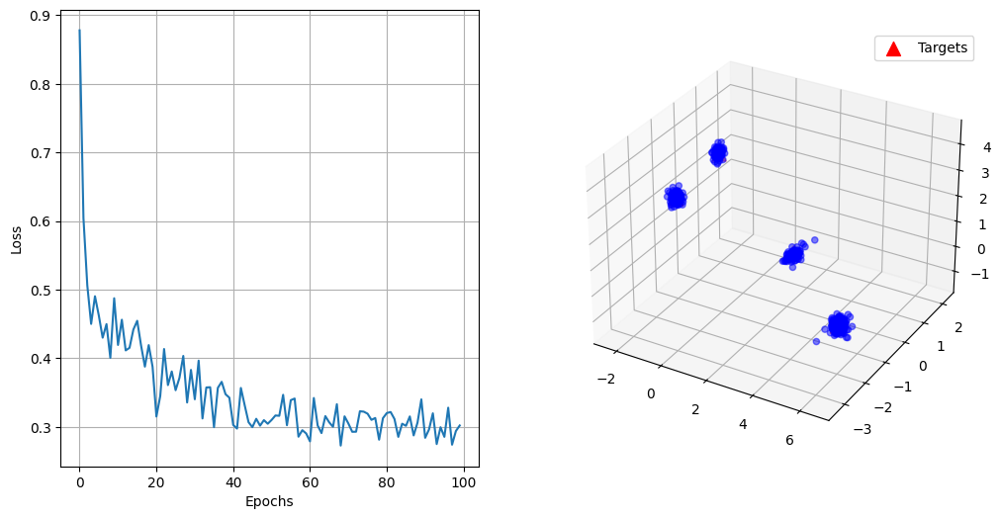

In [21]:
fig = plt.figure(figsize=(12, 6))
ax_hist = fig.add_subplot(121)
ax_hist.plot(history)
ax_hist.set_xlabel("Epochs")
ax_hist.set_ylabel("Loss")
ax_hist.grid()

ax = fig.add_subplot(122, projection='3d')
ax.scatter(samples[:, 0], samples[:, 1], samples[:, 2], c='b', marker='o', alpha=0.5)
ax.scatter(targets[:, 0], targets[:, 1], targets[:, 2], c='r', marker='^', s=100, label='Targets')
ax.legend()
plt.show()

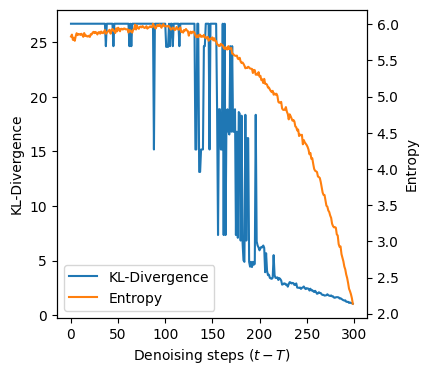

In [22]:
from condevo.stats import kl_divergence_sampled
from condevo.stats import grid_entropy_2d

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

# sample data
samples = sample(vpred,500, 3)

# eval statistics
entropy = [grid_entropy_2d(xt, grid_size=51, range_min=-vpred.diff_range, range_max=vpred.diff_range) for xt in reversed(samples)]
KL_divergence = [kl_divergence_sampled(px, px_hat, grid_size=51, range_min=-vpred.diff_range, range_max=vpred.diff_range) for px_hat in reversed(samples)]

# plot statistics
fig = plt.figure(figsize=(4, 4))
ax = plt.gca()
ax.plot(np.arange(vpred.num_steps), KL_divergence)
ax.set_ylabel("KL-Divergence")
ax.set_xlabel("Denoising steps $(t-T)$")

t_ax = plt.twinx()
t_ax.plot([], label="KL-Divergence")
t_ax.plot(np.arange(vpred.num_steps), entropy, color="tab:orange", label="Entropy")
plt.ylabel("Entropy")
plt.legend()
plt.show()

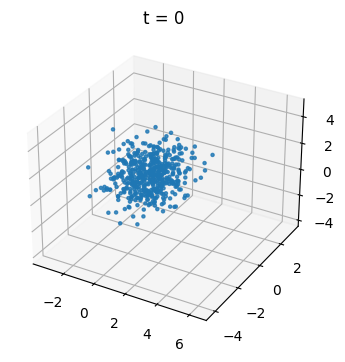

In [23]:
##### plot denoising over time
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

T, N, _ = samples.shape
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111, projection="3d")

# Ensure numpy float array (handles torch tensors too)
samples_np = np.asarray(samples, dtype=float)[::-1]

# Fixed limits
lims = [(samples_np[..., i].min(), samples_np[..., i].max()) for i in range(3)]
ax.set_xlim(lims[0]); ax.set_ylim(lims[1]); ax.set_zlim(lims[2])

# Init
xyz0 = samples_np[0]
scat = ax.scatter(xyz0[:, 0], xyz0[:, 1], xyz0[:, 2], s=5, alpha=0.8)
title = ax.set_title("t = 0")

def update(frame):
    xyz = samples_np[frame]              # (N, 3)
    x = np.asarray(xyz[:, 0]).reshape(-1)
    y = np.asarray(xyz[:, 1]).reshape(-1)
    z = np.asarray(xyz[:, 2]).reshape(-1)
    scat._offsets3d = (x, y, z)
    title.set_text(f"t = {frame}")
    return scat, title

anim = FuncAnimation(fig, update, frames=T, interval=50, blit=False)

display(HTML(anim.to_jshtml()))

## DDIM Accuracy vs. Training Epochs

In [24]:
import torch

stats = {
    "loss": [],
    "samples": [],
    "max_epoch": []
}

num_samples = 10000
dataset_size = 1000
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=weights.numpy(), replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

for max_epoch in (10, 20, 50, 100, 200):
    backbone = get_mlp()
    ddim = get_ddim(backbone, "mlp_test")

    device = "cpu"
    x = x.to(device)
    f = f.to(device)
    ddim = ddim.to(device)

    history = ddim.fit(x, weights=f,
             max_epoch=max_epoch,
             lr=5e-3,
             optimizer="AdamW",
             weight_decay=1e-5,
             )
    stats["loss"].append(history)
    stats["samples"].append(sample(model=ddim, num_samples=num_samples, num_params=num_params))
    stats["max_epoch"].append(max_epoch)

Training Diffusion Model: 100%|██████████| 200/200 [00:42<00:00,  4.73epoch/s, loss=0.0207]


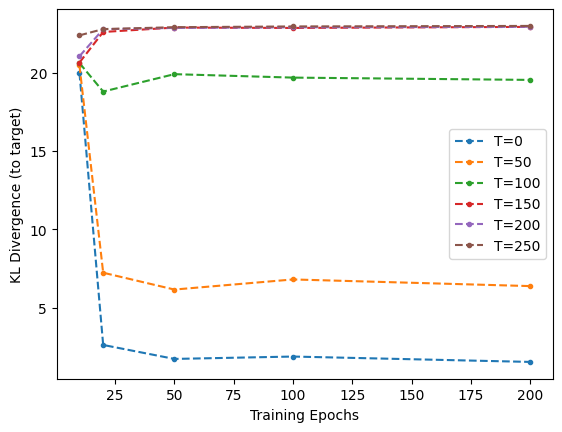

In [25]:
from condevo.stats import kl_divergence_sampled

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

plt.figure()
kl = []
for t in range(0, ddim.num_steps, 50):
    kl.append([kl_divergence_sampled(samples[t], px, grid_size=21, range_min=-ddim.diff_range,) for samples in stats["samples"]])
    plt.plot(stats["max_epoch"], kl[-1], marker=".", linestyle="--", label=f"T={t}")

stats["KL"] = np.array(kl).T
plt.ylabel("KL Divergence (to target)")
plt.xlabel("Training Epochs")
plt.legend()
plt.show()

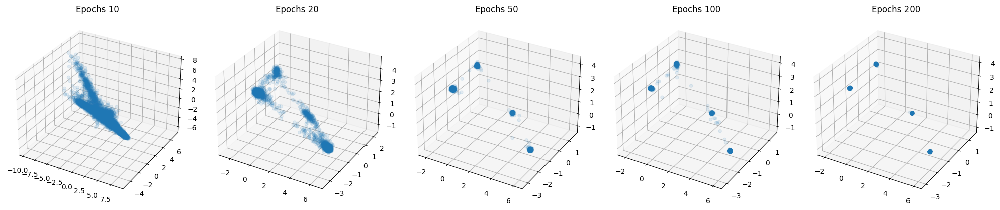

In [26]:
# Filter stats first
filtered = [
    (me, samples[0])
    for me, samples in zip(stats["max_epoch"], stats["samples"])
    if me >= 10
]

n_panels = len(filtered)
if n_panels == 0:
    raise ValueError("No entries with max_epoch >= 3000")

fig = plt.figure(figsize=(4 * n_panels, 4))

for i, (me, samples) in enumerate(filtered):
    ax = fig.add_subplot(1, n_panels, i + 1, projection="3d")
    ax.scatter(
        samples[:, 0],
        samples[:, 1],
        samples[:, 2],
        marker="o",
        alpha=0.1
    )
    ax.set_title(f"Epochs {me}")

plt.tight_layout()
plt.show()


## VPred Accuracy ( + Self-Attention Backbone) vs. Training Epochs

In [27]:
import torch

attn_stats = {
    "loss": [],
    "samples": [],
    "max_epoch": []
}

num_samples = 1000
dataset_size = 1000
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
for t, f, w in zip(targets, fitness, weights):
    print(f"target {t} with fitness {f} is weighted as {w}")

target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=weights.numpy(), replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

for max_epoch in (10, 20, 50, 100, 300):
    attn = get_attn()
    vpred = get_vpred(attn, "attn_test")

    device = "cpu"
    x = x.to(device)
    f = f.to(device)
    vpred = vpred.to(device)

    history = vpred.fit(x, weights=f,
             max_epoch=max_epoch,
             lr=5e-3,
             optimizer="AdamW",
             weight_decay=1e-5,
             )
    attn_stats["loss"].append(history)
    attn_stats["samples"].append(sample(model=vpred, num_samples=num_samples, num_params=num_params))
    attn_stats["max_epoch"].append(max_epoch)

target [ 0.1 -3.   4. ] with fitness 10.0 is weighted as 0.25191763043403625
target [-2.   1.   2.5] with fitness 5.0 is weighted as 0.10515791922807693
target [ 1.   1.4 -1. ] with fitness 5.0 is weighted as 0.10515791922807693
target [ 6. -2.  0.] with fitness 20.0 is weighted as 0.5377665162086487


Training Diffusion Model: 100%|██████████| 300/300 [01:32<00:00,  3.23epoch/s, loss=0.256]


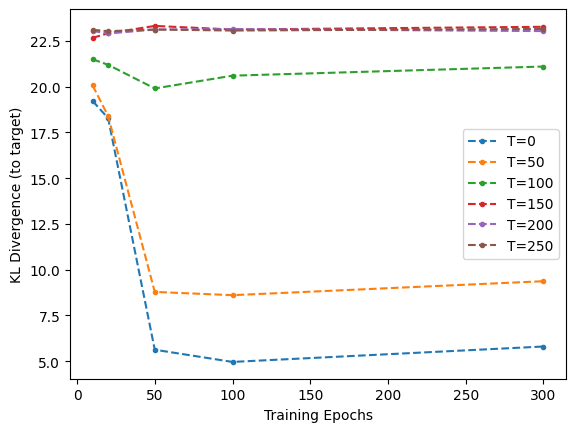

In [28]:
from condevo.stats import kl_divergence_sampled

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

plt.figure()
kl = []
for t in range(0, vpred.num_steps, 50):
    kl.append([kl_divergence_sampled(samples[t], px, grid_size=21, range_min=-ddim.diff_range,) for samples in attn_stats["samples"]])
    plt.plot(attn_stats["max_epoch"], kl[-1], marker=".", linestyle="--", label=f"T={t}")

attn_stats["KL"] = np.array(kl).T
plt.ylabel("KL Divergence (to target)")
plt.xlabel("Training Epochs")
plt.legend()
plt.show()

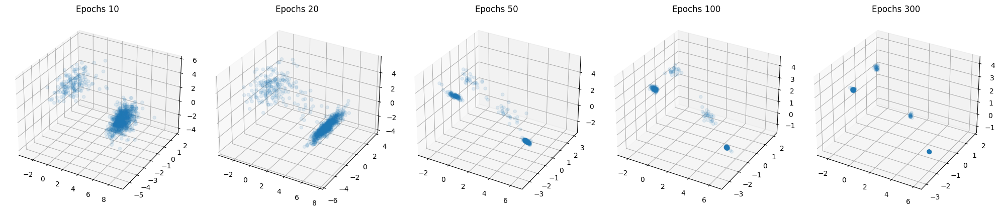

In [29]:
# Filter stats first
filtered = [
    (me, samples[0])
    for me, samples in zip(attn_stats["max_epoch"], attn_stats["samples"])
    if me >= 10
]

n_panels = len(filtered)
if n_panels == 0:
    raise ValueError("No entries with max_epoch >= 3000")

fig = plt.figure(figsize=(4 * n_panels, 4))

for i, (me, samples) in enumerate(filtered):
    ax = fig.add_subplot(1, n_panels, i + 1, projection="3d")
    ax.scatter(
        samples[:, 0],
        samples[:, 1],
        samples[:, 2],
        marker="o",
        alpha=0.1
    )
    ax.set_title(f"Epochs {me}")

plt.tight_layout()
plt.show()


In [10]:
import torch

dataset_size = 1000
max_epochs = 20
device = "cpu"

# augment dataset -> make dataset large enough so learning progress is smooth
weights = roulette_wheel(torch.tensor(fitness, dtype=torch.float), s=1, normalize=True)
for t, f, w in zip(targets, fitness, weights):
    print(f"target {t} with fitness {f} is weighted as {w}")

target_idx_training = np.random.choice(np.arange(len(targets)), size=dataset_size, p=None, replace=True)

# convert to torch tensors
x = torch.tensor(targets[target_idx_training], dtype=torch.float).to(device)
f = weights[target_idx_training][:, None].to(device)

# initialize model
backbone = get_mlp()
# backbone = get_unet()
xpred = get_xpred(model=backbone, backbone="mlp_test")
xpred = xpred.to(device)

# train
history = xpred.fit(
    x,
    weights=f,
    max_epoch=max_epochs,
    lr=3e-3,
    optimizer="Adam",
    weight_decay=1e-5,
)

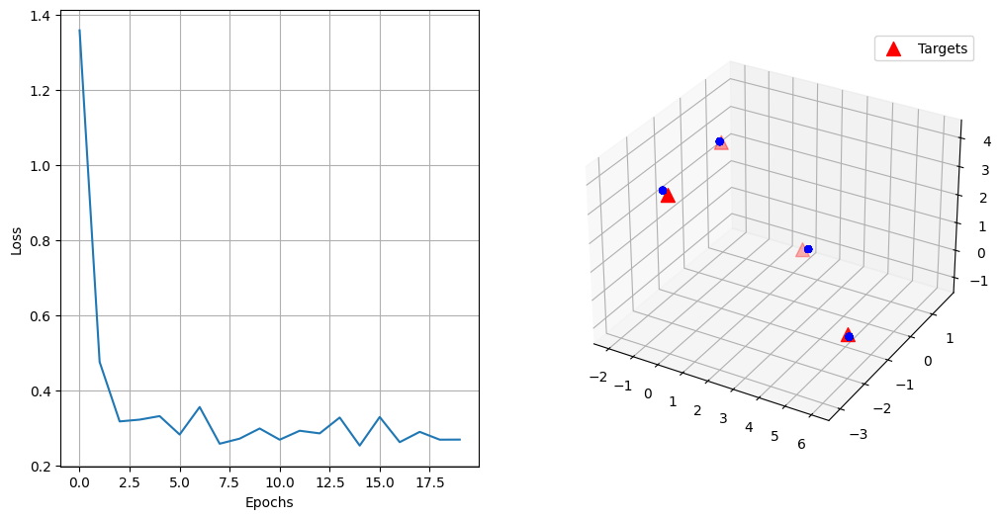

In [12]:
samples = xpred.sample(shape=(num_params,), num=1000)

count = []
for t in targets:
    dt = torch.linalg.norm(samples - t, dim=-1)
    count.append((dt < 0.5).sum().item() / len(samples))

for t, f, w, c in zip(targets, fitness, weights, count):
    print(f"target {t} weighted by {w:.3f}: sampling rate {c}")

fig = plt.figure(figsize=(12, 6))
ax_hist = fig.add_subplot(121)
ax_hist.plot(history)
ax_hist.set_xlabel("Epochs")
ax_hist.set_ylabel("Loss")
ax_hist.grid()

ax = fig.add_subplot(122, projection='3d')

ax.scatter(samples[:, 0], samples[:, 1], samples[:, 2], c='b', marker='o', alpha=0.5)
ax.scatter(targets[:, 0], targets[:, 1], targets[:, 2], c='r', marker='^', s=100, label='Targets')
ax.legend()
plt.show()

In [13]:
### Analyze the denoising stack of DDIM models
@torch.no_grad()
def sample_xpred(model, num_samples, num_params, t_start=None):
    # sample entire denoising stack (num_(t_)steps, num_samples, num_params) for t in [T, 0]
    if t_start is None:
        t_start = model.num_steps - 1

    xt = torch.randn(t_start + 1, num_samples, num_params)  # RETURN entire denoising stack
    one = torch.ones(num_samples, 1, device=xt.device, dtype=xt.dtype)

    for T in range(t_start, 0, -1):
        t = one * model._step_discrete_to_continuous(T)
        a = model.alpha[T - 1]
        s = model.sigma[T] * model.noise_level
        z = torch.randn_like(xt[T])

        model_prediction = model(xt[T], t)
        eps, x0_pred = model.get_clamped_eps_x0(xt[T], model_prediction, T)

        eps_sqrt_term = (1 - a - s ** 2).clamp_min(0).sqrt()
        xt[T - 1] = a.sqrt() * x0_pred + eps_sqrt_term * eps + s * z

    return xt

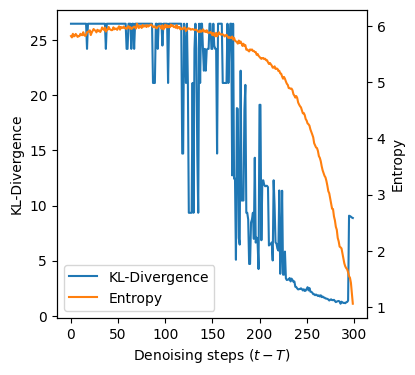

In [14]:
from condevo.stats import kl_divergence_sampled
from condevo.stats import grid_entropy_2d

# generate PD from target x according to fitness
pd_size = 2000
idx = np.random.choice(np.arange(len(targets)), p=weights, size=pd_size)
px = x[idx]

# sample data
samples = sample_xpred(xpred, 500, 3)

# eval statistics
entropy = [grid_entropy_2d(xt, grid_size=51, range_min=-xpred.diff_range, range_max=xpred.diff_range) for xt in
           reversed(samples)]
KL_divergence = [kl_divergence_sampled(px, px_hat, grid_size=51, range_min=-xpred.diff_range, range_max=xpred.diff_range)
                 for px_hat in reversed(samples)]

# plot statistics
fig = plt.figure(figsize=(4, 4))
ax = plt.gca()
ax.plot(np.arange(xpred.num_steps), KL_divergence)
ax.set_ylabel("KL-Divergence")
ax.set_xlabel("Denoising steps $(t-T)$")

t_ax = plt.twinx()
t_ax.plot([], label="KL-Divergence")
t_ax.plot(np.arange(xpred.num_steps), entropy, color="tab:orange", label="Entropy")
plt.ylabel("Entropy")
plt.legend()
plt.show()

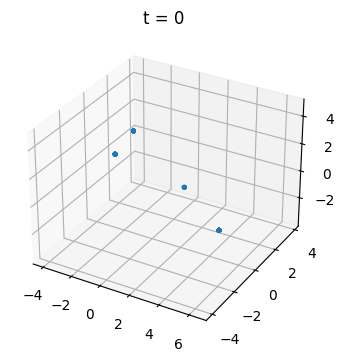

In [16]:
##### plot denoising over time
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

T, N, _ = samples.shape
fig = plt.figure(figsize=(4, 4))
ax = fig.add_subplot(111, projection="3d")

# Ensure numpy float array (handles torch tensors too)
samples_np = np.asarray(samples, dtype=float)[::-1]

# Fixed limits
lims = [(samples_np[..., i].min(), samples_np[..., i].max()) for i in range(3)]
ax.set_xlim(lims[0]);
ax.set_ylim(lims[1]);
ax.set_zlim(lims[2])

# Init
xyz0 = samples_np[0]
scat = ax.scatter(xyz0[:, 0], xyz0[:, 1], xyz0[:, 2], s=5, alpha=0.8)
title = ax.set_title("t = 0")


def update(frame):
    xyz = samples_np[frame]  # (N, 3)
    x = np.asarray(xyz[:, 0]).reshape(-1)
    y = np.asarray(xyz[:, 1]).reshape(-1)
    z = np.asarray(xyz[:, 2]).reshape(-1)
    scat._offsets3d = (x, y, z)
    title.set_text(f"t = {frame}")
    return scat, title


anim = FuncAnimation(fig, update, frames=T, interval=50, blit=False)

display(HTML(anim.to_jshtml()))